# Landcover Segmentation with ResUNet-a

In [1]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, random_split
from segmentation_models_pytorch.losses import DiceLoss
from segmentation_models_pytorch.metrics.functional import get_stats, iou_score
from tqdm import tqdm
import numpy as np
import seaborn as sns

from dataset import SatelliteImageDataset
from res_unet_a import ResUNetA
from utils import (
    one_hot_to_image,
    plot_prediction,
    compute_accuracy,
    class_index_to_one_hot,
    class_index_to_image,
    get_color_patches,
    print_iou,
    get_iou_by_class
)


C:\Users\admin\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Load the dataset and split it into training and testing set

In [2]:
dataset = SatelliteImageDataset(
    image_dir='data/images',
    mask_dir='data/masks'
)

In [3]:
gen = torch.Generator()
gen.manual_seed(0)

train_set, test_set = random_split(dataset, [0.8, 0.2], generator=gen)

Visulize the 1st image in the dataset

In [4]:
img, mask = dataset[0]

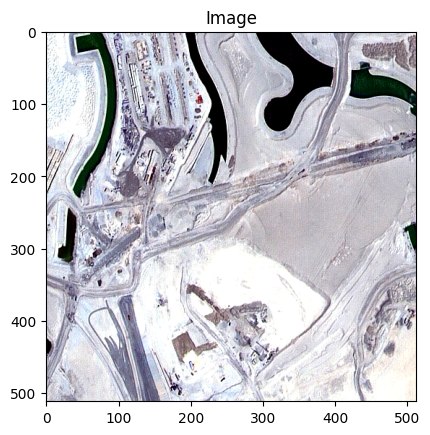

In [5]:
plt.imshow(img.permute(1, 2, 0))
plt.title('Image')
plt.show()

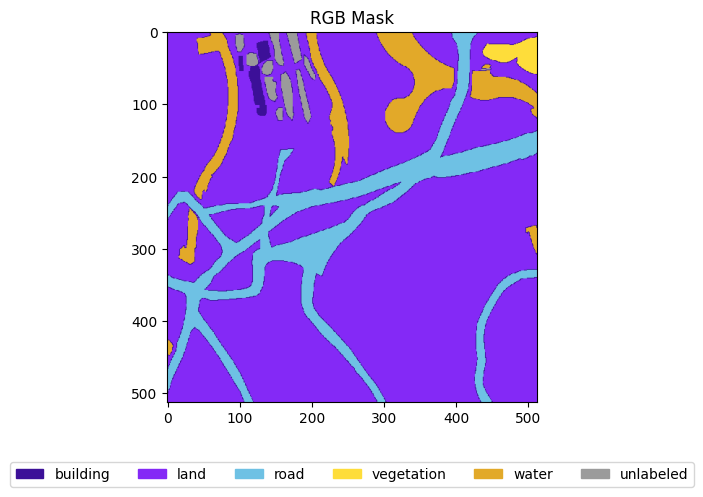

In [6]:
mask_rgb = class_index_to_image(torch.unsqueeze(mask, 0), dataset.color_map)[0]
plt.imshow(mask_rgb.permute(1, 2, 0))

patches = get_color_patches(dataset.color_map, dataset.mask_labels)
plt.legend(handles=patches, loc='lower center', bbox_to_anchor=(0.5, -0.25), fontsize=10, ncol=6)

plt.title('RGB Mask')
plt.show()

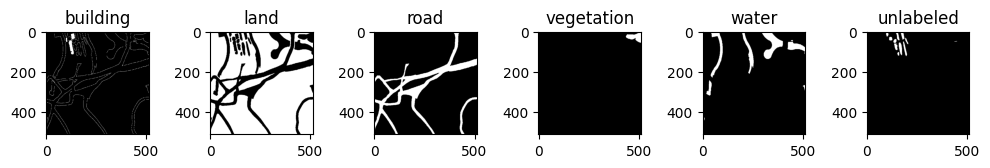

In [7]:
fig, axes = plt.subplots(1, 6, figsize=(10, 8))
mask = class_index_to_one_hot(mask, dataset.color_map)

for i in range(6):
    axes[i].imshow(mask[i], cmap='gray')
    axes[i].set_title(dataset.mask_labels[i])

plt.tight_layout()
plt.show()

In [8]:
gen = torch.Generator()
gen.manual_seed(0)

train_loader = DataLoader(train_set, shuffle=True, generator=gen)
test_loader = DataLoader(test_set)

Define the hyperparameters, optimizers and criterion function for the model 

In [9]:
LEARNING_RATE = 3e-4
EPOCHS = 100

In [10]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = ResUNetA(in_channels=3, out_channels=6).to(device)

In [11]:
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
criterion = DiceLoss('multiclass').to(device)

Train the model

Epoch 1:


Training: 100%|██████████| 163/163 [01:02<00:00,  2.63it/s]


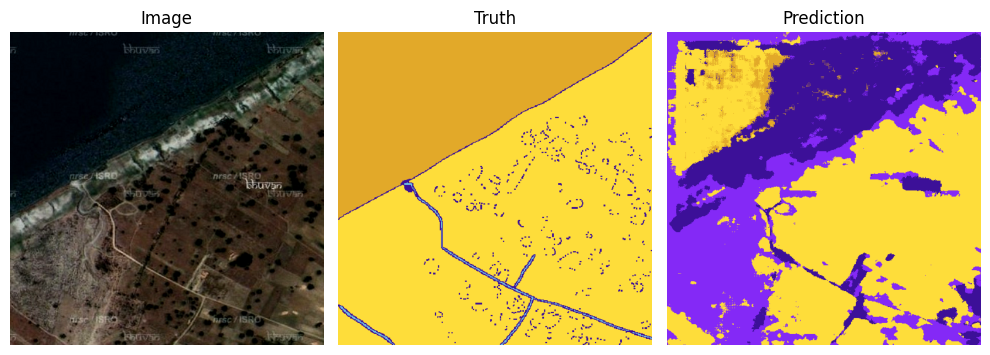

Accuracy: 0.4865 | Loss: 0.4986


Epoch 2:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.65it/s]


Accuracy: 0.5500 | Loss: 0.4349


Epoch 3:


Training: 100%|██████████| 163/163 [01:02<00:00,  2.60it/s]


Accuracy: 0.5749 | Loss: 0.4179


Epoch 4:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.64it/s]


Accuracy: 0.5900 | Loss: 0.3942


Epoch 5:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.71it/s]


Accuracy: 0.6069 | Loss: 0.3700


Epoch 6:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.70it/s]


Accuracy: 0.6272 | Loss: 0.3542


Epoch 7:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.70it/s]


Accuracy: 0.6430 | Loss: 0.3439


Epoch 8:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.69it/s]


Accuracy: 0.6751 | Loss: 0.3289


Epoch 9:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.6921 | Loss: 0.3233


Epoch 10:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.7097 | Loss: 0.3170


Epoch 11:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


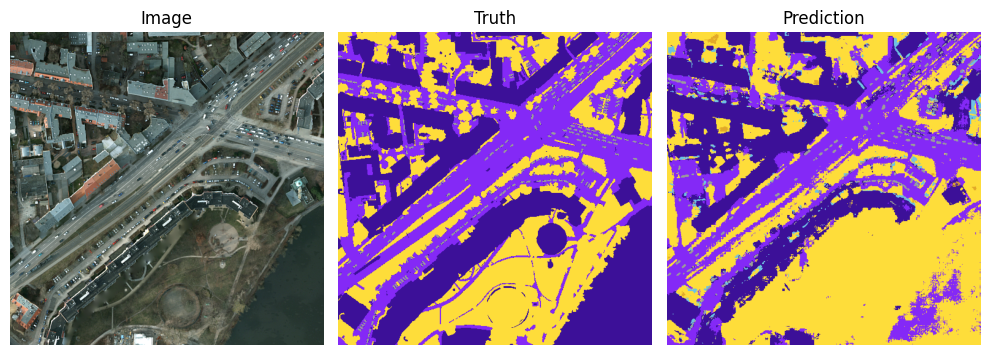

Accuracy: 0.7216 | Loss: 0.3121


Epoch 12:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.7353 | Loss: 0.3043


Epoch 13:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7497 | Loss: 0.2984


Epoch 14:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7556 | Loss: 0.2951


Epoch 15:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7454 | Loss: 0.2969


Epoch 16:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7669 | Loss: 0.2853


Epoch 17:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.69it/s]


Accuracy: 0.7821 | Loss: 0.2788


Epoch 18:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7830 | Loss: 0.2756


Epoch 19:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.7686 | Loss: 0.2856


Epoch 20:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7844 | Loss: 0.2714


Epoch 21:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


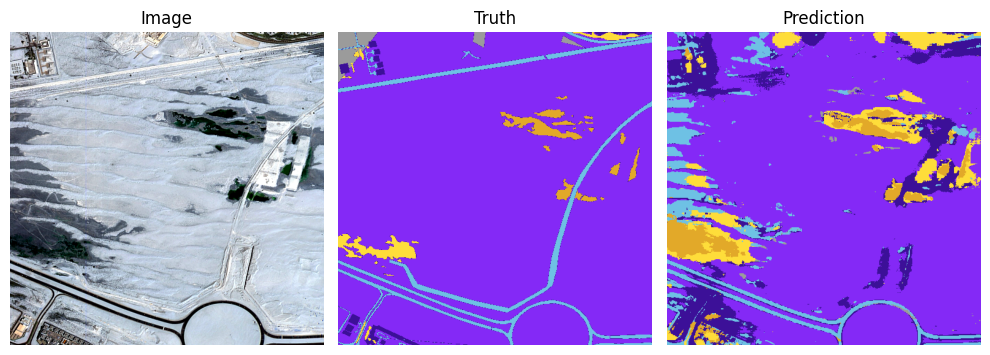

Accuracy: 0.7989 | Loss: 0.2624


Epoch 22:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8019 | Loss: 0.2601


Epoch 23:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.7879 | Loss: 0.2687


Epoch 24:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8037 | Loss: 0.2594


Epoch 25:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8078 | Loss: 0.2527


Epoch 26:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8111 | Loss: 0.2486


Epoch 27:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8102 | Loss: 0.2484


Epoch 28:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8162 | Loss: 0.2417


Epoch 29:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8225 | Loss: 0.2355


Epoch 30:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8145 | Loss: 0.2434


Epoch 31:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


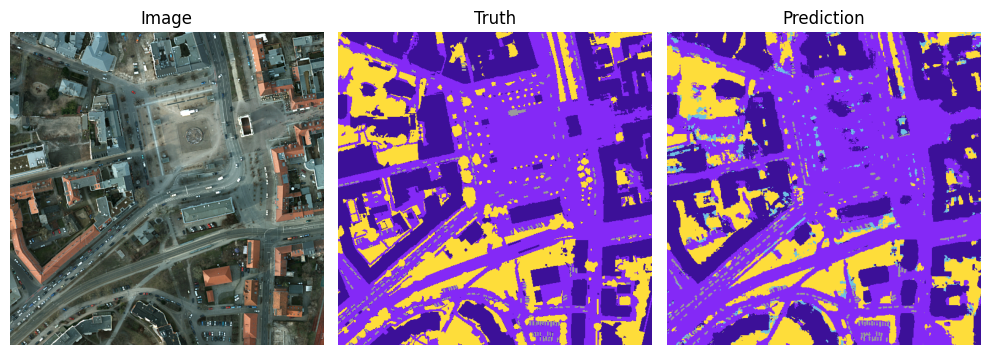

Accuracy: 0.8262 | Loss: 0.2352


Epoch 32:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8205 | Loss: 0.2350


Epoch 33:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8306 | Loss: 0.2269


Epoch 34:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8354 | Loss: 0.2233


Epoch 35:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8343 | Loss: 0.2228


Epoch 36:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8294 | Loss: 0.2289


Epoch 37:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8221 | Loss: 0.2306


Epoch 38:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8339 | Loss: 0.2246


Epoch 39:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8410 | Loss: 0.2182


Epoch 40:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8446 | Loss: 0.2120


Epoch 41:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


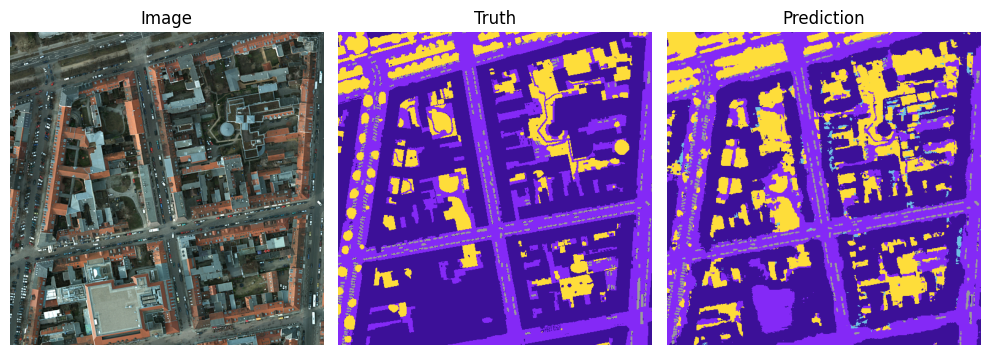

Accuracy: 0.8461 | Loss: 0.2087


Epoch 42:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8448 | Loss: 0.2116


Epoch 43:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8487 | Loss: 0.2069


Epoch 44:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8503 | Loss: 0.2055


Epoch 45:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8509 | Loss: 0.2069


Epoch 46:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8528 | Loss: 0.2005


Epoch 47:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8530 | Loss: 0.2005


Epoch 48:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8475 | Loss: 0.2078


Epoch 49:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8522 | Loss: 0.1996


Epoch 50:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8427 | Loss: 0.2097


Epoch 51:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


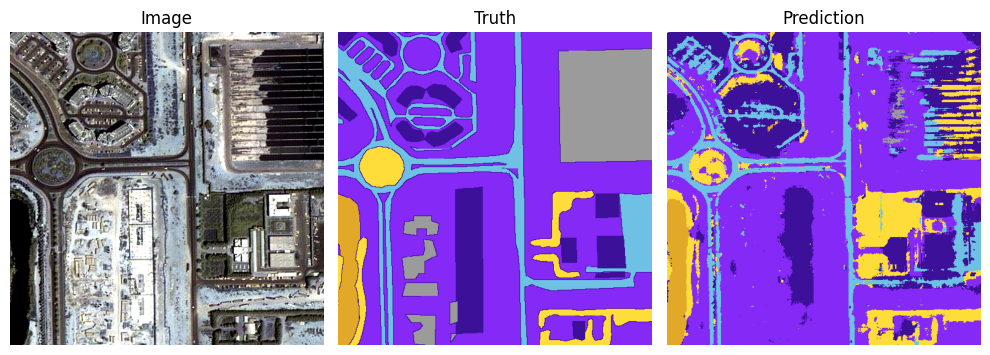

Accuracy: 0.8554 | Loss: 0.1962


Epoch 52:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8581 | Loss: 0.1929


Epoch 53:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.66it/s]


Accuracy: 0.8606 | Loss: 0.1909


Epoch 54:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8608 | Loss: 0.1893


Epoch 55:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8641 | Loss: 0.1843


Epoch 56:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8616 | Loss: 0.1860


Epoch 57:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8628 | Loss: 0.1858


Epoch 58:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8645 | Loss: 0.1849


Epoch 59:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8324 | Loss: 0.2062


Epoch 60:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8645 | Loss: 0.1835


Epoch 61:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


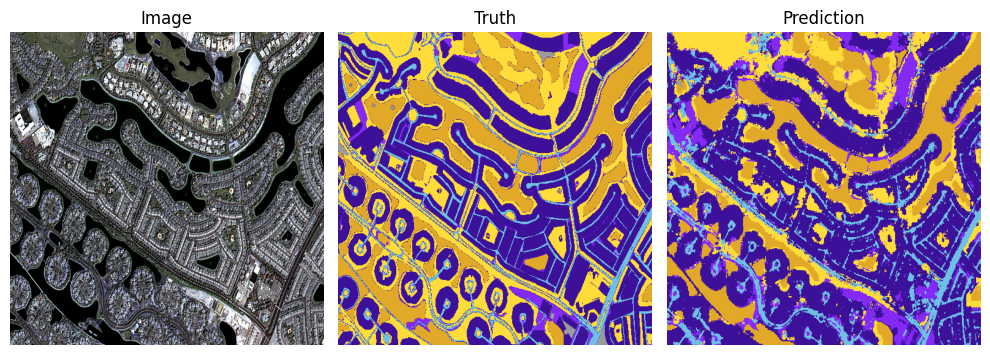

Accuracy: 0.8704 | Loss: 0.1749


Epoch 62:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8634 | Loss: 0.1833


Epoch 63:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8537 | Loss: 0.1965


Epoch 64:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8707 | Loss: 0.1756


Epoch 65:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8726 | Loss: 0.1721


Epoch 66:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8729 | Loss: 0.1720


Epoch 67:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8749 | Loss: 0.1705


Epoch 68:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8627 | Loss: 0.1805


Epoch 69:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8742 | Loss: 0.1694


Epoch 70:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8777 | Loss: 0.1664


Epoch 71:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


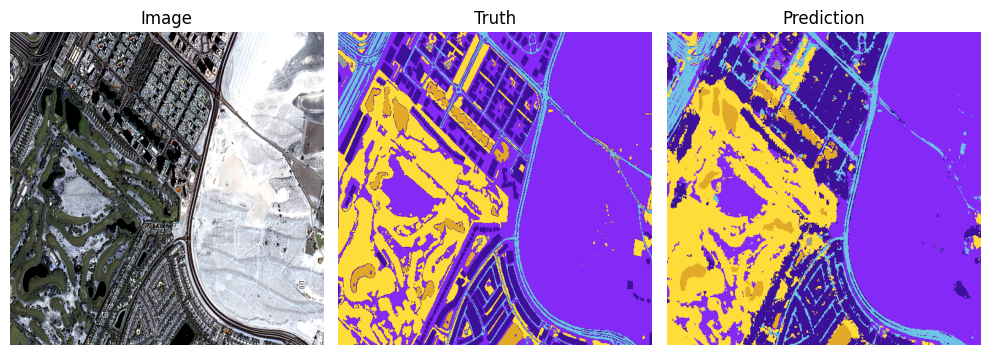

Accuracy: 0.8805 | Loss: 0.1618


Epoch 72:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8809 | Loss: 0.1619


Epoch 73:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8745 | Loss: 0.1694


Epoch 74:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8770 | Loss: 0.1662


Epoch 75:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8774 | Loss: 0.1652


Epoch 76:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8826 | Loss: 0.1587


Epoch 77:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8834 | Loss: 0.1569


Epoch 78:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8769 | Loss: 0.1660


Epoch 79:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.66it/s]


Accuracy: 0.8787 | Loss: 0.1639


Epoch 80:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8834 | Loss: 0.1583


Epoch 81:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


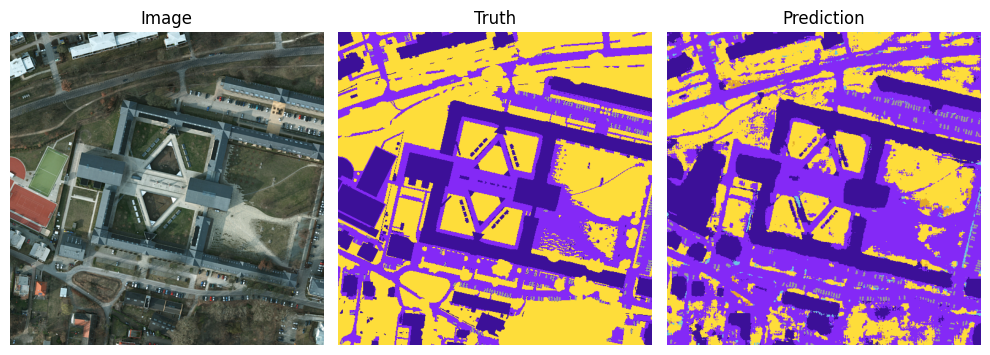

Accuracy: 0.8779 | Loss: 0.1639


Epoch 82:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8540 | Loss: 0.1919


Epoch 83:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.66it/s]


Accuracy: 0.8659 | Loss: 0.1797


Epoch 84:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.68it/s]


Accuracy: 0.8710 | Loss: 0.1733


Epoch 85:


Training: 100%|██████████| 163/163 [01:00<00:00,  2.67it/s]


Accuracy: 0.8863 | Loss: 0.1543


Epoch 86:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.66it/s]


Accuracy: 0.8895 | Loss: 0.1496


Epoch 87:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.66it/s]


Accuracy: 0.8915 | Loss: 0.1468


Epoch 88:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8924 | Loss: 0.1453


Epoch 89:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8912 | Loss: 0.1468


Epoch 90:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8902 | Loss: 0.1478


Epoch 91:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


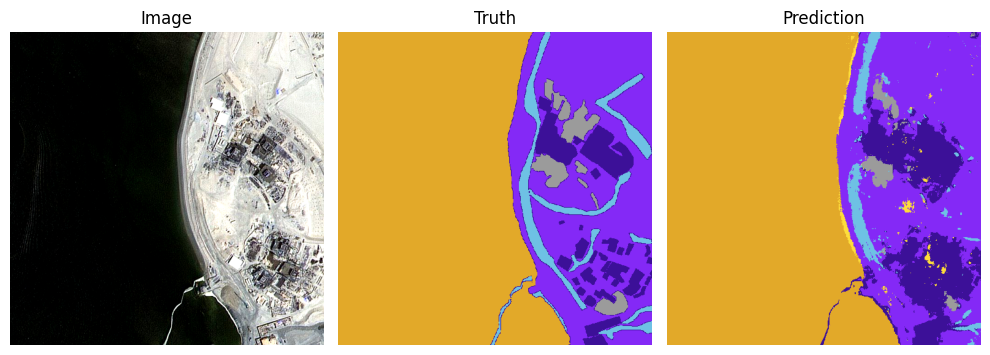

Accuracy: 0.8922 | Loss: 0.1460


Epoch 92:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8913 | Loss: 0.1463


Epoch 93:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8876 | Loss: 0.1505


Epoch 94:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8853 | Loss: 0.1542


Epoch 95:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8852 | Loss: 0.1535


Epoch 96:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8813 | Loss: 0.1594


Epoch 97:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8894 | Loss: 0.1493


Epoch 98:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.66it/s]


Accuracy: 0.8932 | Loss: 0.1452


Epoch 99:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]


Accuracy: 0.8933 | Loss: 0.1445


Epoch 100:


Training: 100%|██████████| 163/163 [01:01<00:00,  2.67it/s]

Accuracy: 0.8940 | Loss: 0.1438




In [12]:
loss_list = []
acc_list = []

for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}:')

    model.train()
    running_loss = 0
    running_acc = 0

    for x, y in tqdm(train_loader, desc='Training', colour='#00FF00'):
        x, y = x.to(device), y.to(device) # y: (b, h, w)
        y_pred = model(x) # y_pred: (b, 6, h, w)

        loss = criterion(y_pred, y)
        running_loss += loss.item()

        # compute the accuracy of the prediction
        running_acc += compute_accuracy(y, y_pred, device)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    if epoch % 10 == 0:
        # show first image in the last batch with matplotlib
        y_imgs = class_index_to_image(y, dataset.color_map, device)
        pred_imgs = one_hot_to_image(y_pred, dataset.color_map, device)
        plot_prediction(x, y_imgs, pred_imgs, dataset.color_map, dataset.mask_labels)

    epoch_acc = running_acc / len(train_loader)
    epoch_loss = running_loss / len(train_loader)
    acc_list.append(epoch_acc)
    loss_list.append(epoch_loss)

    print(f'Accuracy: {epoch_acc:.4f} | Loss: {epoch_loss:.4f}')
    print('\n')


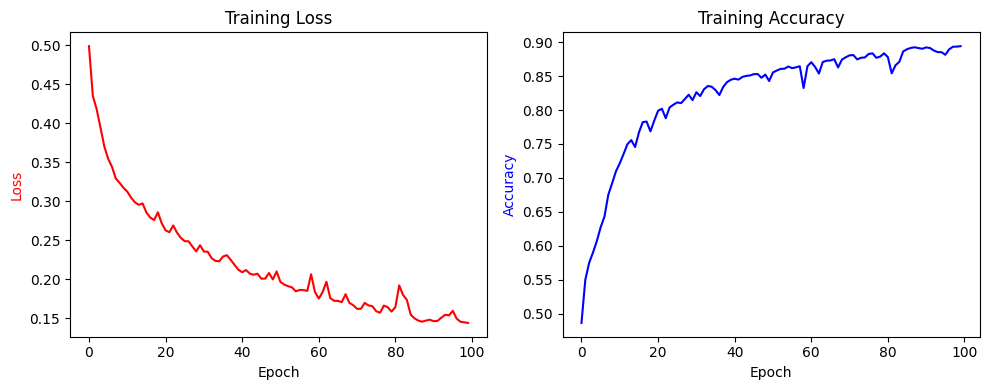

In [13]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].plot(loss_list, color='red')
axes[0].set_ylabel('Loss', color='red')
axes[0].set_xlabel('Epoch')
axes[0].set_title('Training Loss')

axes[1].plot(acc_list, color='blue')
axes[1].set_ylabel('Accuracy', color='blue')
axes[1].set_xlabel('Epoch')
axes[1].set_title('Training Accuracy')

plt.tight_layout()
plt.show()

Test the model with the test set

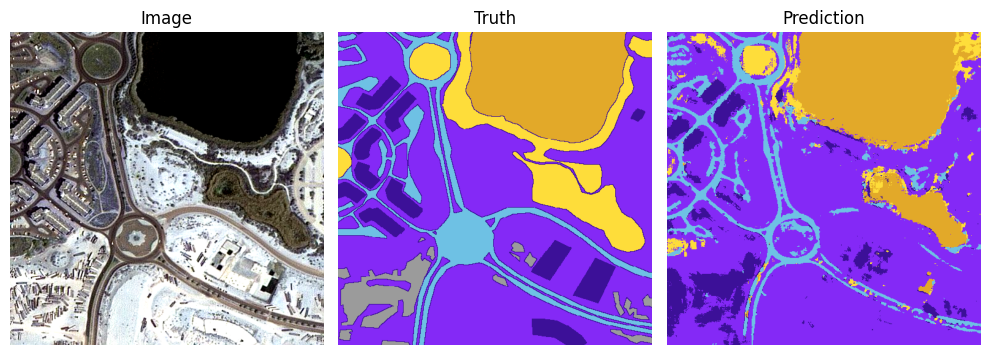

Accuracy: 0.6945 | Loss: 0.5116
IOU... building: 0.16 land: 0.68 road: 0.46 vegetation: 0.21 water: 0.75 unlabeled: 0.00 




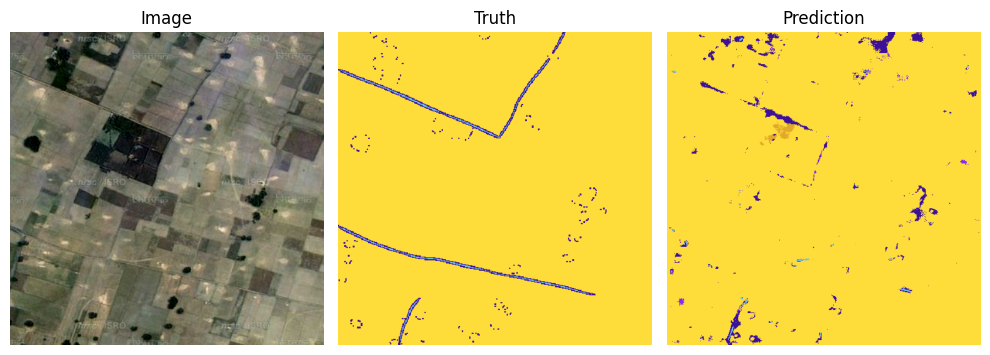

Accuracy: 0.9606 | Loss: 0.2917
IOU... building: 0.11 road: 0.04 vegetation: 0.96 




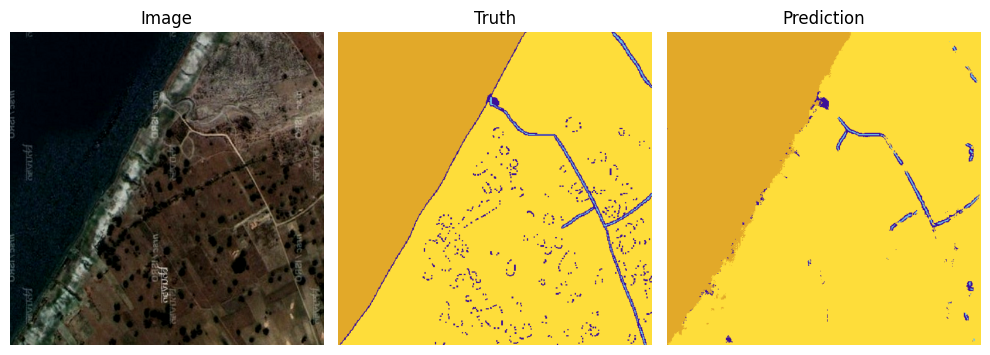

Accuracy: 0.9571 | Loss: 0.2370
IOU... building: 0.12 road: 0.26 vegetation: 0.94 water: 0.97 unlabeled: 1.00 




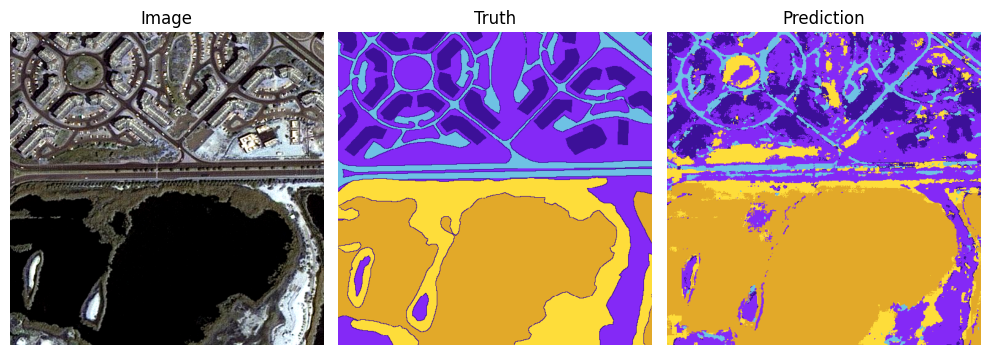

Accuracy: 0.6372 | Loss: 0.3667
IOU... building: 0.34 land: 0.46 road: 0.33 vegetation: 0.19 water: 0.74 




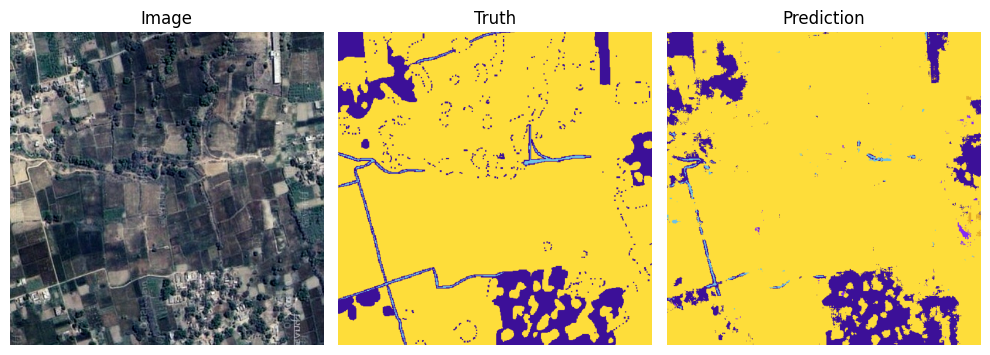

Accuracy: 0.9196 | Loss: 0.1652
IOU... building: 0.54 road: 0.21 vegetation: 0.92 




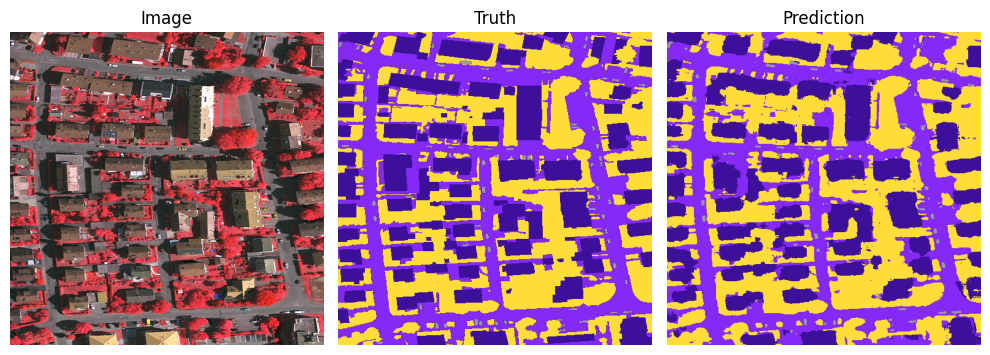

Accuracy: 0.8574 | Loss: 0.1298
IOU... building: 0.73 land: 0.71 vegetation: 0.81 unlabeled: 0.48 




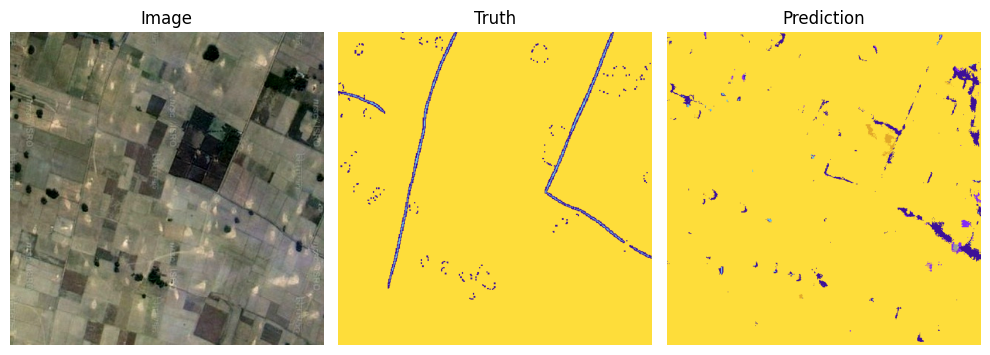

Accuracy: 0.9605 | Loss: 0.3002
IOU... building: 0.10 road: 0.02 vegetation: 0.96 




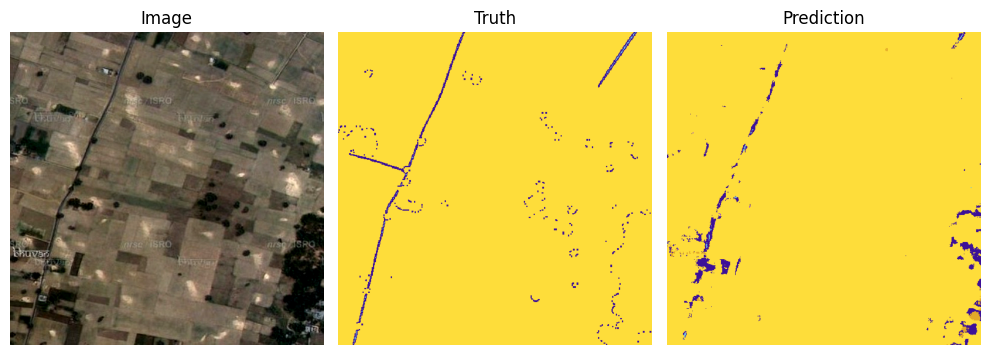

Accuracy: 0.9717 | Loss: 0.2764
IOU... building: 0.12 road: 0.07 vegetation: 0.97 




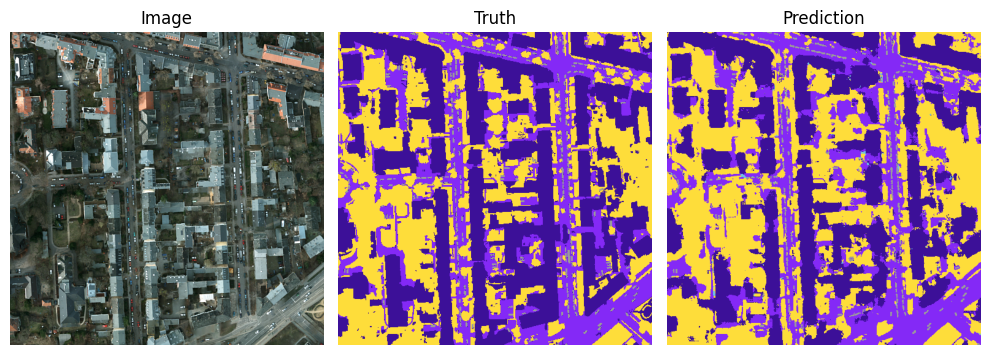

Accuracy: 0.7784 | Loss: 0.1612
IOU... building: 0.68 land: 0.49 vegetation: 0.71 unlabeled: 0.58 




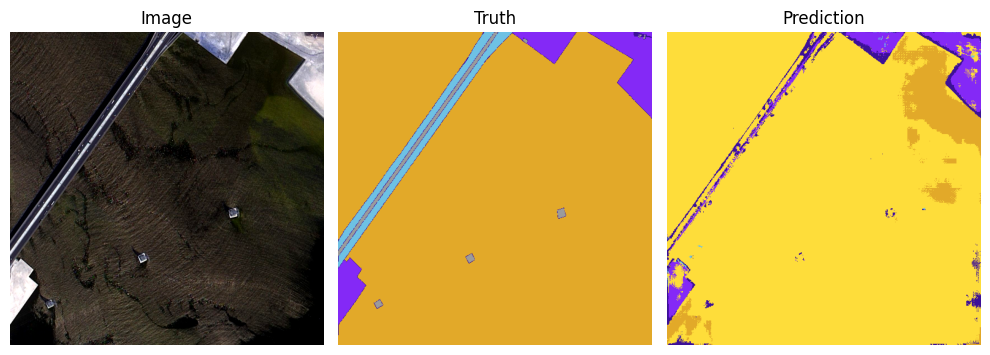

Accuracy: 0.0932 | Loss: 0.6604
IOU... building: 0.08 land: 0.62 road: 0.00 water: 0.07 




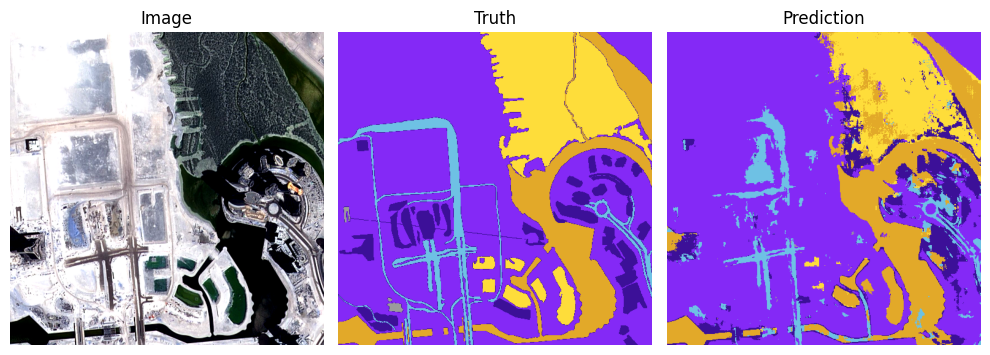

Accuracy: 0.7536 | Loss: 0.4802
IOU... building: 0.19 land: 0.73 road: 0.28 vegetation: 0.59 water: 0.64 




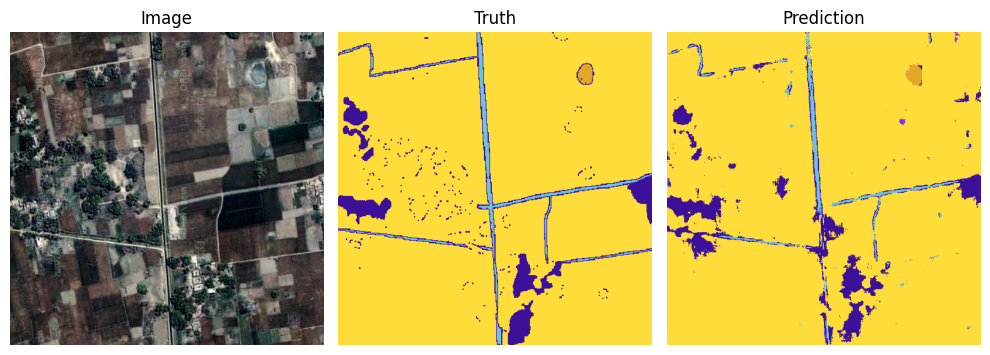

Accuracy: 0.9413 | Loss: 0.1454
IOU... building: 0.40 road: 0.49 vegetation: 0.95 water: 0.87 




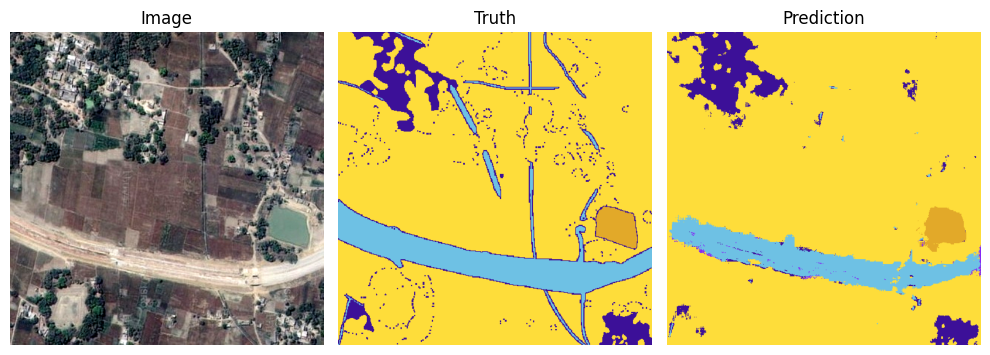

Accuracy: 0.9051 | Loss: 0.1301
IOU... building: 0.40 road: 0.69 vegetation: 0.90 water: 0.79 unlabeled: 1.00 




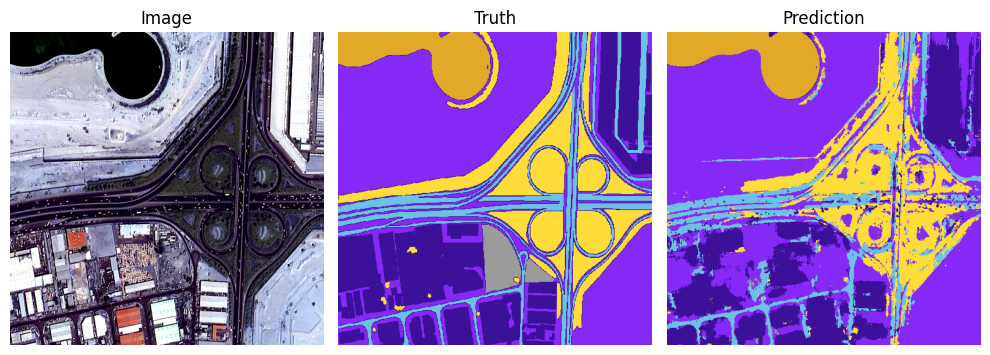

Accuracy: 0.6817 | Loss: 0.4180
IOU... building: 0.44 land: 0.61 road: 0.33 vegetation: 0.48 water: 0.98 




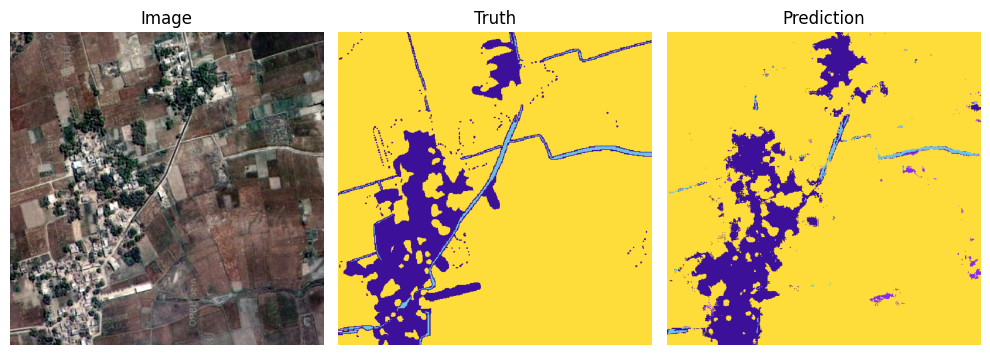

Accuracy: 0.9131 | Loss: 0.1385
IOU... building: 0.55 road: 0.34 vegetation: 0.91 




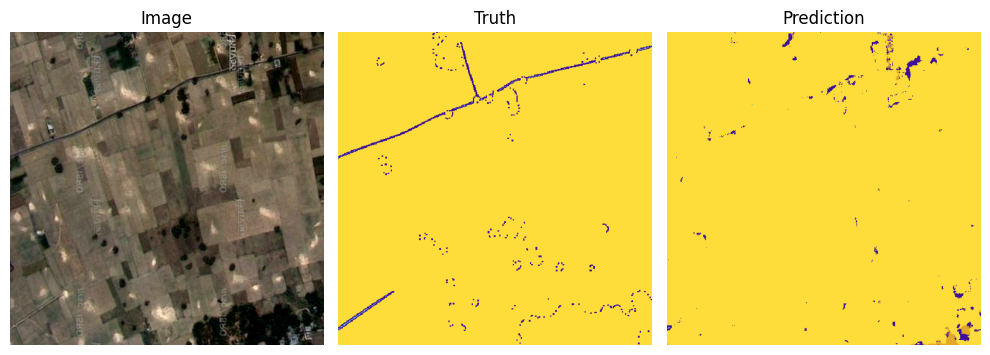

Accuracy: 0.9742 | Loss: 0.3100
IOU... building: 0.06 road: 0.02 vegetation: 0.97 




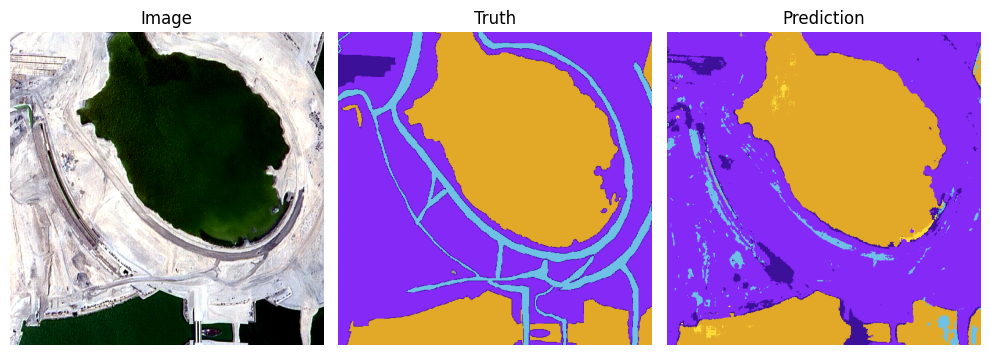

Accuracy: 0.8286 | Loss: 0.4640
IOU... building: 0.16 land: 0.75 road: 0.06 water: 0.95 




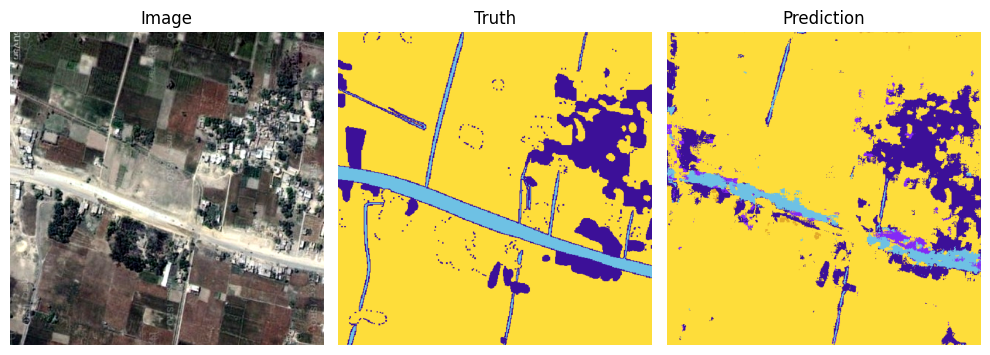

Accuracy: 0.8689 | Loss: 0.1401
IOU... building: 0.47 road: 0.42 vegetation: 0.87 unlabeled: 1.00 




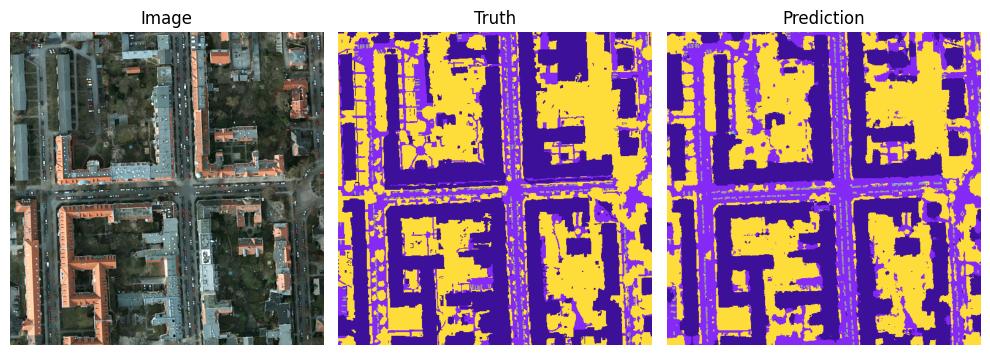

Accuracy: 0.8272 | Loss: 0.1321
IOU... building: 0.78 land: 0.54 vegetation: 0.74 unlabeled: 0.64 




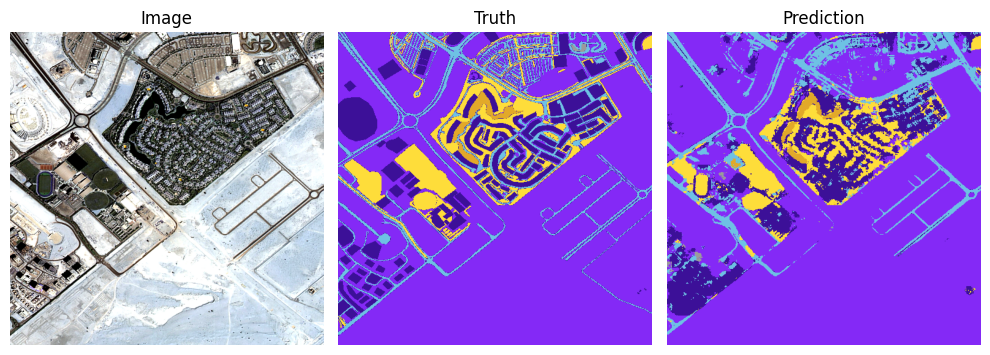

Accuracy: 0.7805 | Loss: 0.4433
IOU... building: 0.36 land: 0.82 road: 0.34 vegetation: 0.40 water: 0.71 




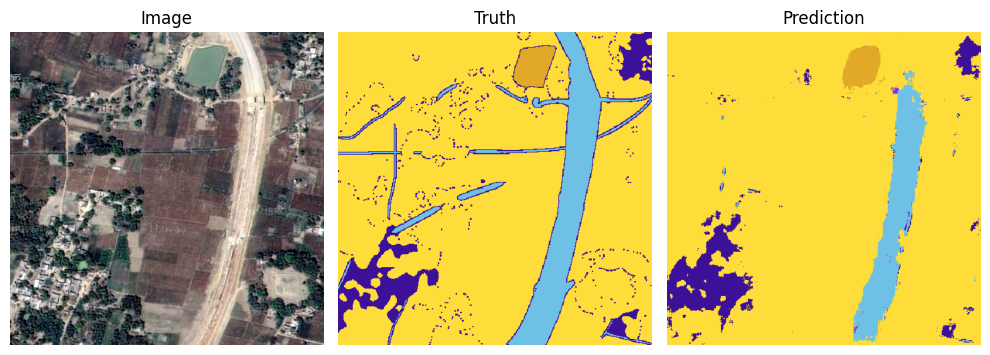

Accuracy: 0.8963 | Loss: 0.1387
IOU... building: 0.36 road: 0.62 vegetation: 0.89 water: 0.86 unlabeled: 1.00 




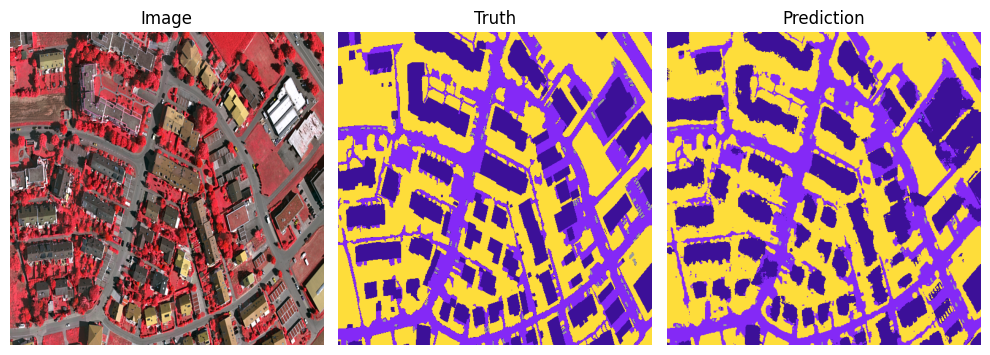

Accuracy: 0.8682 | Loss: 0.1732
IOU... building: 0.71 land: 0.72 vegetation: 0.84 unlabeled: 0.23 




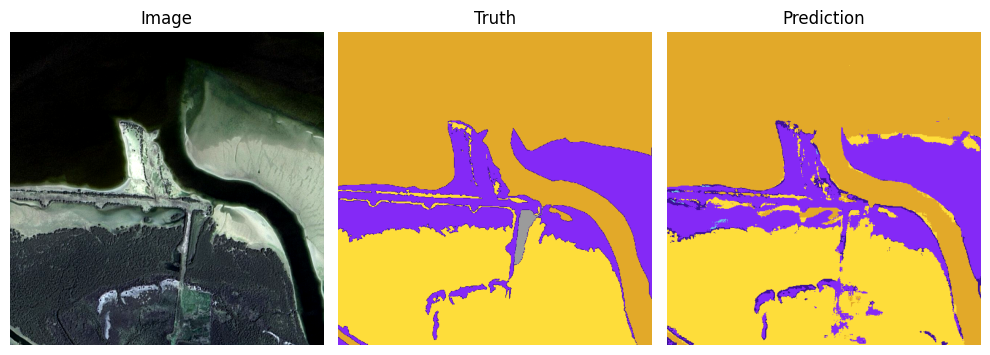

Accuracy: 0.9258 | Loss: 0.3277
IOU... building: 0.14 land: 0.79 vegetation: 0.88 water: 0.94 




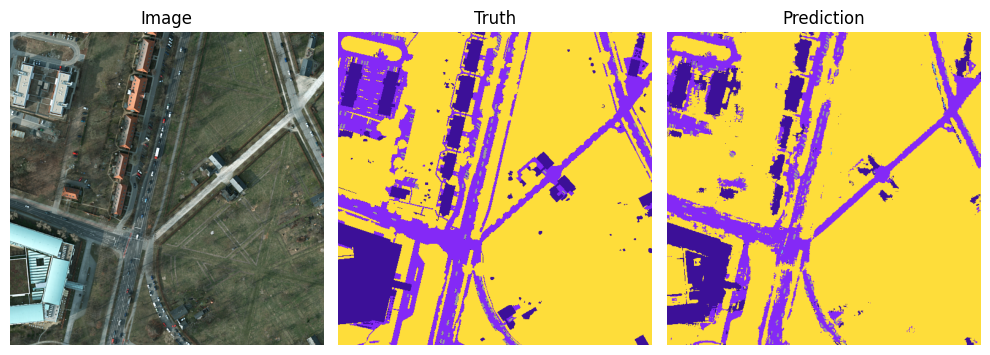

Accuracy: 0.8811 | Loss: 0.1459
IOU... building: 0.60 land: 0.61 vegetation: 0.87 water: 1.00 unlabeled: 0.53 




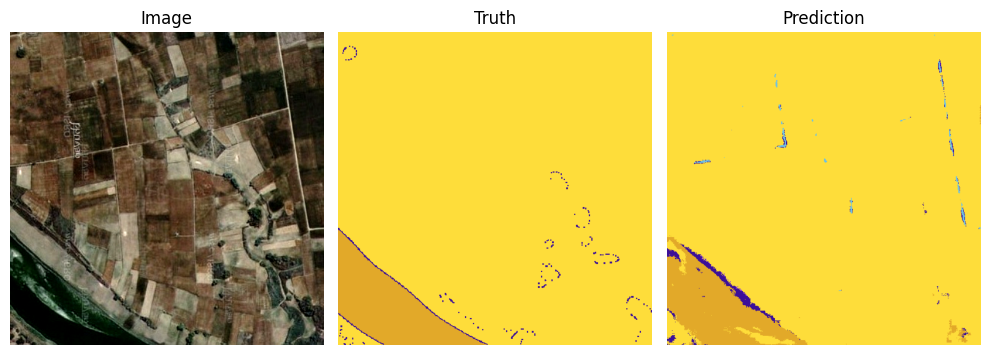

Accuracy: 0.9749 | Loss: 0.1598
IOU... building: 0.08 vegetation: 0.98 water: 0.83 




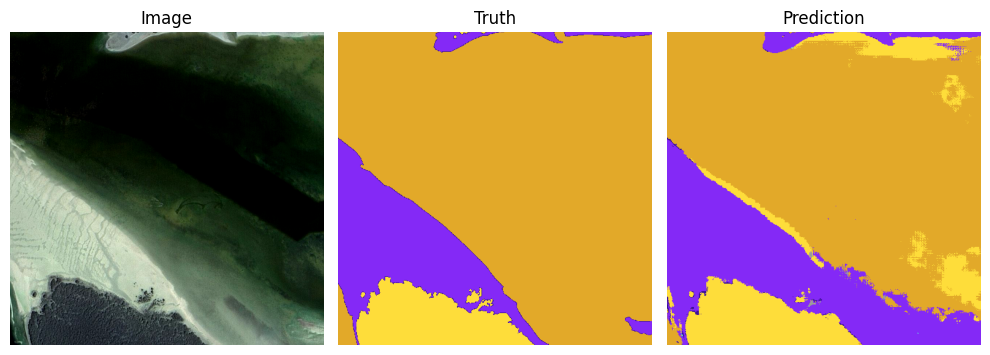

Accuracy: 0.8598 | Loss: 0.2442
IOU... building: 0.07 land: 0.68 vegetation: 0.54 water: 0.83 




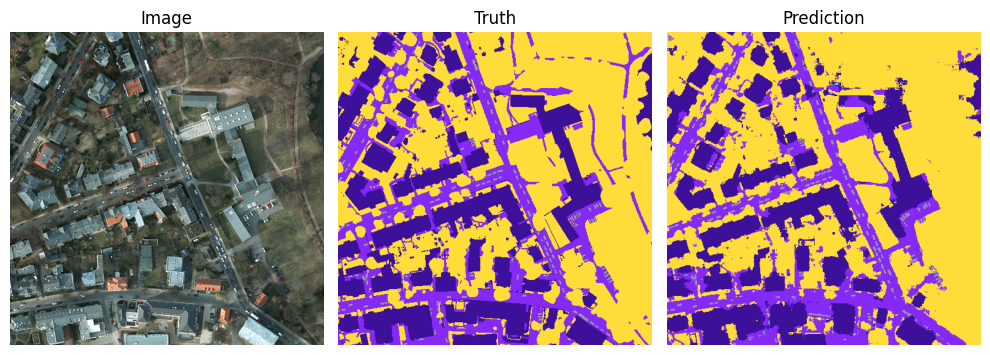

Accuracy: 0.8390 | Loss: 0.1412
IOU... building: 0.72 land: 0.53 vegetation: 0.81 unlabeled: 0.57 




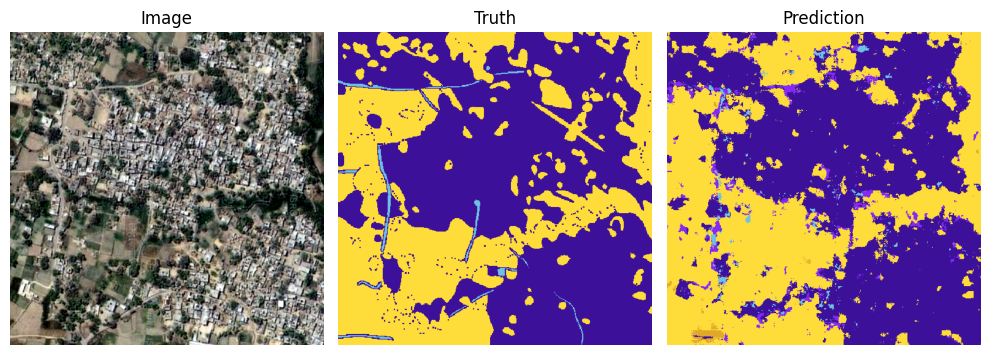

Accuracy: 0.8004 | Loss: 0.2170
IOU... building: 0.72 road: 0.03 vegetation: 0.67 




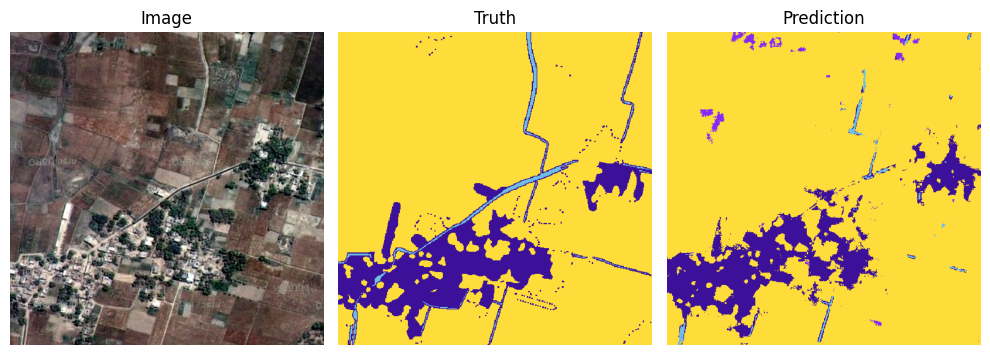

Accuracy: 0.9142 | Loss: 0.1656
IOU... building: 0.58 road: 0.19 vegetation: 0.91 




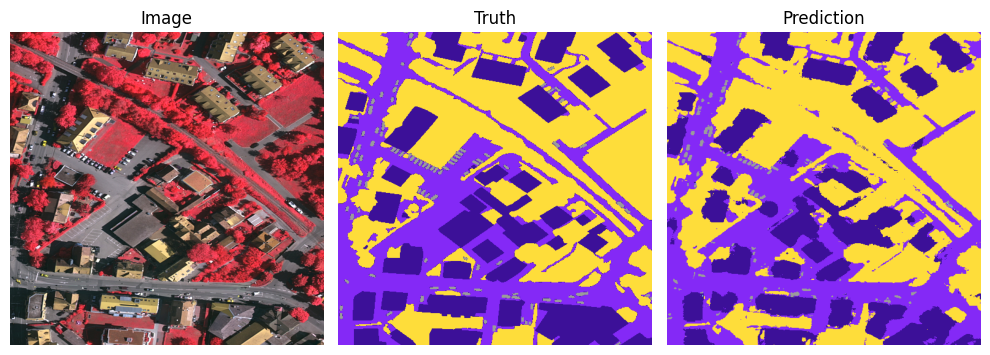

Accuracy: 0.8888 | Loss: 0.1332
IOU... building: 0.75 land: 0.75 vegetation: 0.88 unlabeled: 0.38 




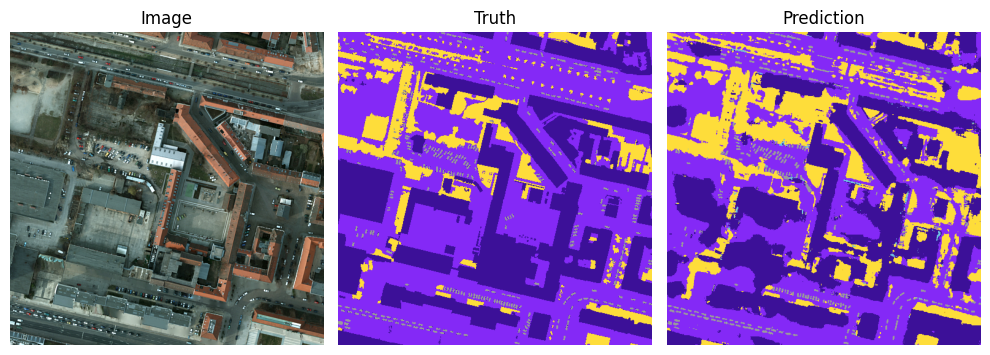

Accuracy: 0.7554 | Loss: 0.1748
IOU... building: 0.64 land: 0.64 vegetation: 0.48 unlabeled: 0.59 




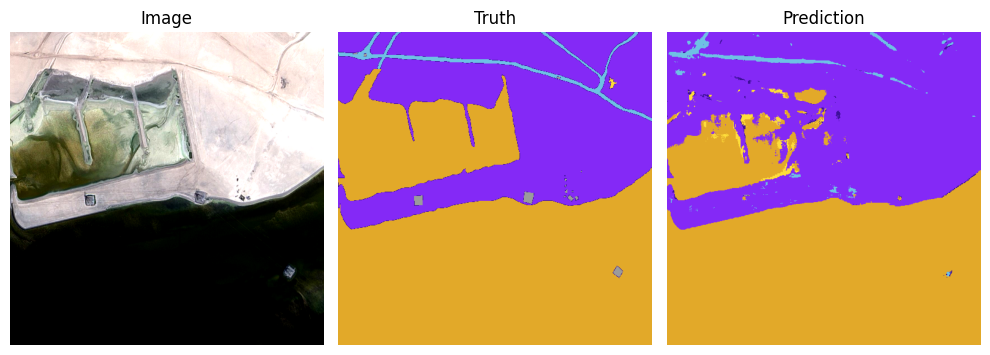

Accuracy: 0.8943 | Loss: 0.5994
IOU... building: 0.02 land: 0.80 road: 0.38 water: 0.86 unlabeled: 0.00 




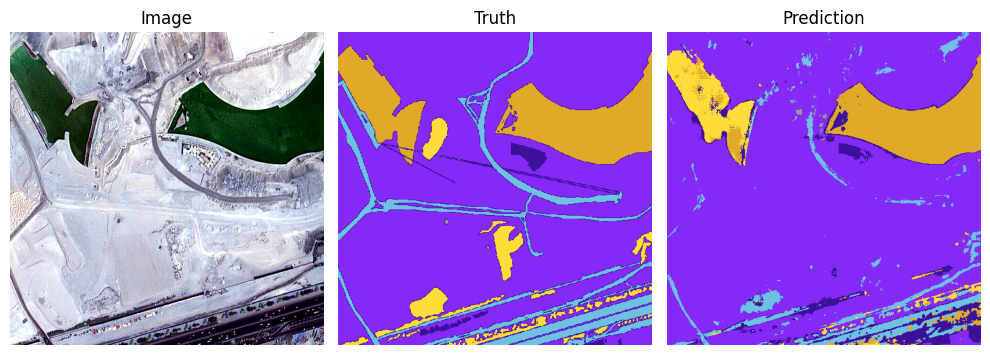

Accuracy: 0.7997 | Loss: 0.5858
IOU... building: 0.18 land: 0.84 road: 0.26 vegetation: 0.03 water: 0.68 




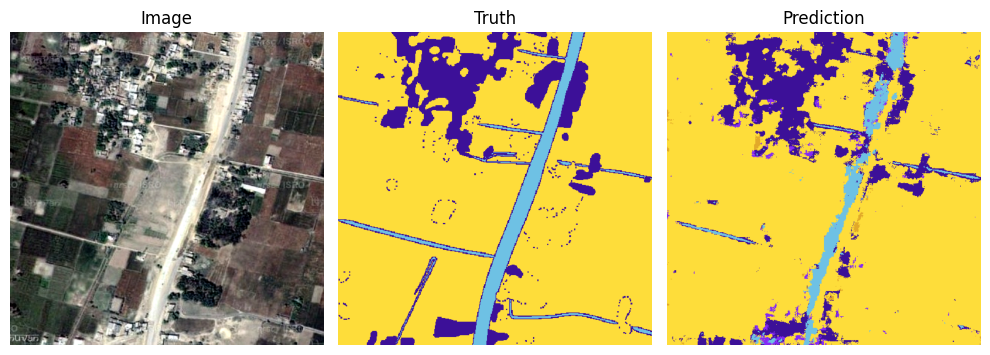

Accuracy: 0.8629 | Loss: 0.1609
IOU... building: 0.51 road: 0.28 vegetation: 0.86 




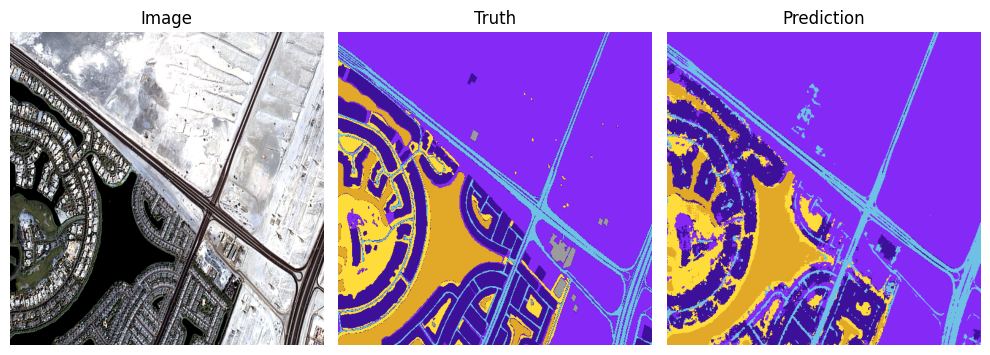

Accuracy: 0.8301 | Loss: 0.3572
IOU... building: 0.53 land: 0.85 road: 0.59 vegetation: 0.41 water: 0.85 unlabeled: 0.00 




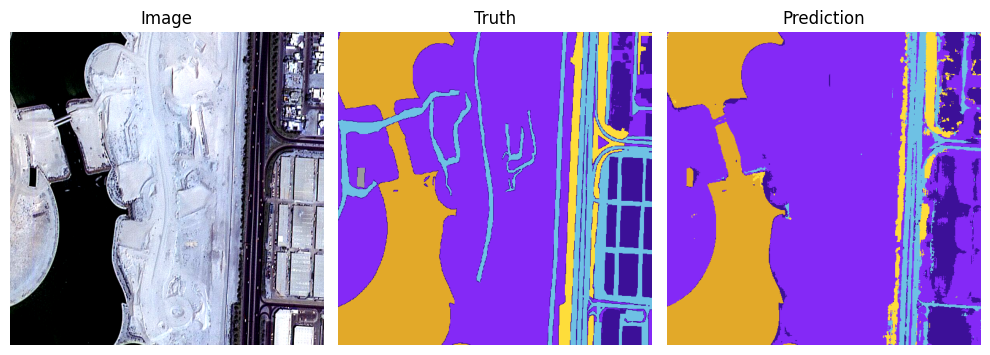

Accuracy: 0.7954 | Loss: 0.4233
IOU... building: 0.34 land: 0.74 road: 0.31 vegetation: 0.47 water: 0.98 




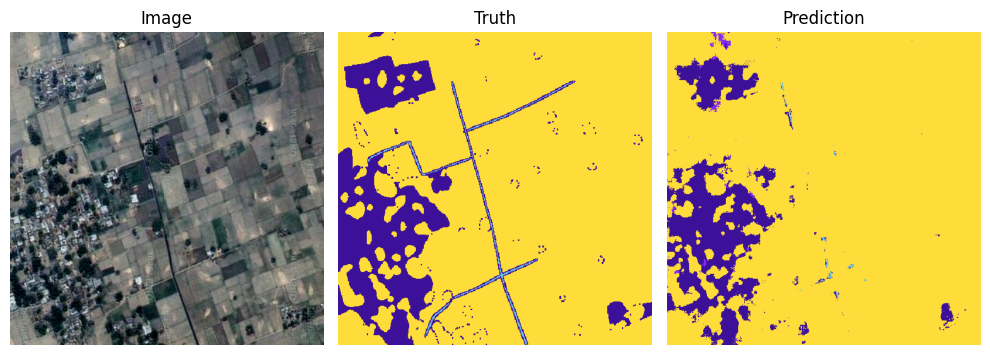

Accuracy: 0.9181 | Loss: 0.1946
IOU... building: 0.59 road: 0.07 vegetation: 0.91 




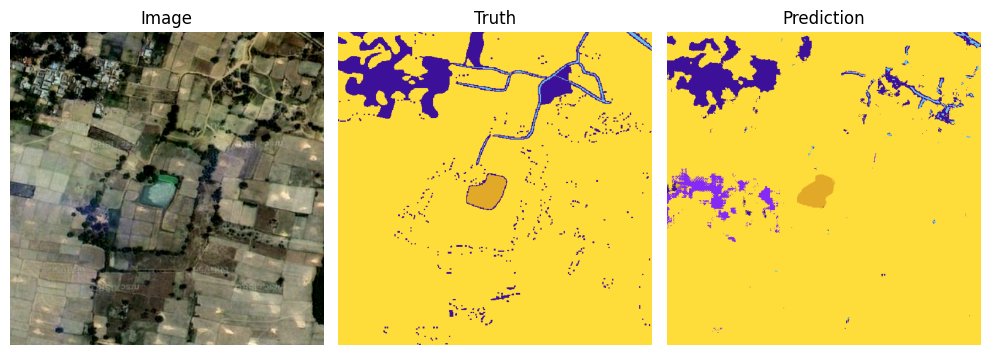

Accuracy: 0.9291 | Loss: 0.2093
IOU... building: 0.45 road: 0.15 vegetation: 0.93 water: 0.84 




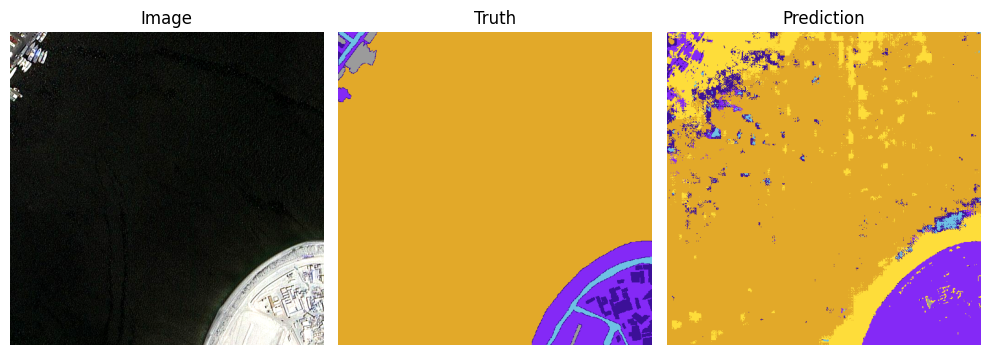

Accuracy: 0.7967 | Loss: 0.5504
IOU... building: 0.01 land: 0.59 water: 0.82 unlabeled: 0.02 




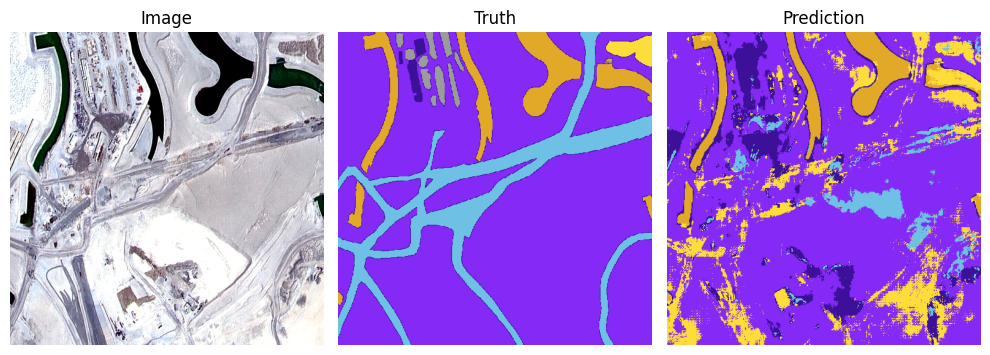

Accuracy: 0.6629 | Loss: 0.6531
IOU... building: 0.12 land: 0.69 road: 0.05 vegetation: 0.04 water: 0.81 




In [14]:
test_acc_list = []
iou_list = torch.tensor([])
count = 0

with torch.no_grad():
    for x, y in test_loader:
        x, y = x.to(device), y.to(device) # y: (b, h, w)
        y_pred = model(x) # y_pred: (b, 6, h, w)

        loss = criterion(y_pred, y)

        # compute accuracy 
        acc = compute_accuracy(y, y_pred, device)
        test_acc_list.append(acc.item())

        # compute iou scores 
        y_pred_argmax = torch.argmax(y_pred, 1)
        tp, fp, fn, tn = get_stats(y_pred_argmax, y, mode='multiclass', num_classes=6)
        iou = iou_score(tp, fp, fn, tn)
        iou_list = torch.cat((iou_list, iou))

        # print predicted images
        y_imgs = class_index_to_image(y, dataset.color_map, device)
        pred_imgs = one_hot_to_image(y_pred, dataset.color_map, device)
        plot_prediction(x, y_imgs, pred_imgs, dataset.color_map, dataset.mask_labels)

        count += 1

        print(f'Accuracy: {acc:.4f} | Loss: {loss:.4f}')
        print_iou(iou[0], dataset.mask_labels)
        print('\n')

In [15]:
mean_test_acc = np.mean(test_acc_list)
print(f'The mean test set accuracy is {mean_test_acc:.4f}')

The mean test set accuracy is 0.8349


In [16]:
iou_scores = get_iou_by_class(iou_list, avg=True)
print_iou(iou_scores, dataset.mask_labels)

mean_iou_scores = np.mean(iou_scores)
print(f'Mean IOU: {mean_iou_scores}')

IOU... building: 0.37 land: 0.68 road: 0.26 vegetation: 0.72 water: 0.81 unlabeled: 0.50 
Mean IOU: 0.5570516536633173


Save the model for future inference

In [17]:
checkpoint = {
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'train_loss_list': loss_list,
    'train_acc_list': acc_list,
    'test_acc': mean_test_acc,
    'test_iou_scores': get_iou_by_class(iou_list),
    'test_mean_iou_scores': get_iou_by_class(iou_list, avg=True)
}

In [18]:
torch.save(checkpoint, 'res_unet_a/res_unet_a_100ep_checkpoint.pth')

Visualize the model accuracy

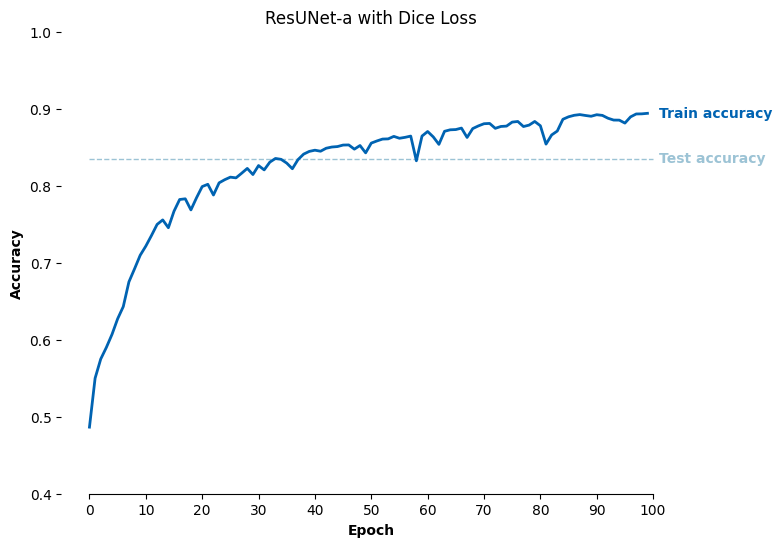

In [20]:
fig, ax = plt.subplots(figsize=(8, 6))

ax.plot(
    [0, EPOCHS], 
    [mean_test_acc, mean_test_acc],
    label="Test accuracy",
    color="#9CC3D5FF",
    linestyle="--",
    linewidth=1,
)

ax.text(
    EPOCHS * 1.01,
    mean_test_acc,
    "Test accuracy",
    color="#9CC3D5FF",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.plot(
    acc_list,
    label="Train accuracy",
    color="#0063B2FF",
    linewidth=2,
)

ax.text(
    EPOCHS * 1.01,
    acc_list[-1],
    "Train accuracy",
    color="#0063B2FF",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.spines["bottom"].set_bounds(0, EPOCHS)

ax.set_xticks(np.arange(0, EPOCHS + 1, 10))
ax.set_yticks(np.arange(0.4, 1.1, 0.1))

ax.set_xlabel("Epoch", fontweight="bold")
ax.set_ylabel("Accuracy", fontweight="bold")

plt.title('ResUNet-a with Dice Loss')
plt.show()

Show the IOU score for each class

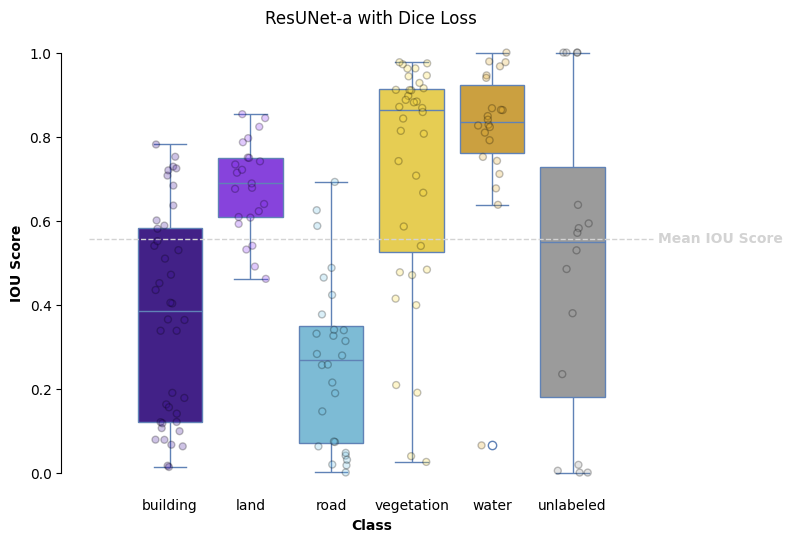

In [21]:
iou_scores = get_iou_by_class(iou_list)

fig, ax = plt.subplots(figsize=(8, 6))

sns.boxplot(
    iou_scores,
    palette=['#3C1098', '#8429F6', '#6EC1E4', '#FEDD3A', '#E2A929', '#9B9B9B'],
    ax=ax,
    linecolor='#6082B6'
)
sns.stripplot(
    iou_scores,
    palette=['#3C1098', '#8429F6', '#6EC1E4', '#FEDD3A', '#E2A929', '#9B9B9B'],
    ax=ax,
    alpha=0.25,
    edgecolor='black',
    linewidth=1,
    jitter=0.2
)
ax.plot(
    [-1, 6], 
    [mean_iou_scores, mean_iou_scores],
    label="Test accuracy",
    color="lightgray",
    linestyle="--",
    linewidth=1,
)
ax.text(
    6 * 1.01,
    mean_iou_scores,
    "Mean IOU Score",
    color="lightgray",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.set_xticks(range(dataset.num_classes), dataset.mask_labels)
ax.tick_params(axis='x', length=0)

ax.spines["right"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.spines["left"].set_bounds(0, 1)

ax.set_xlabel('Class', fontweight="bold")
ax.set_ylabel('IOU Score', fontweight="bold")

plt.title('ResUNet-a with Dice Loss')
plt.show()